<a href="https://colab.research.google.com/github/wannasmile/colab_code_note/blob/main/MTL000.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#多目标优化及应用

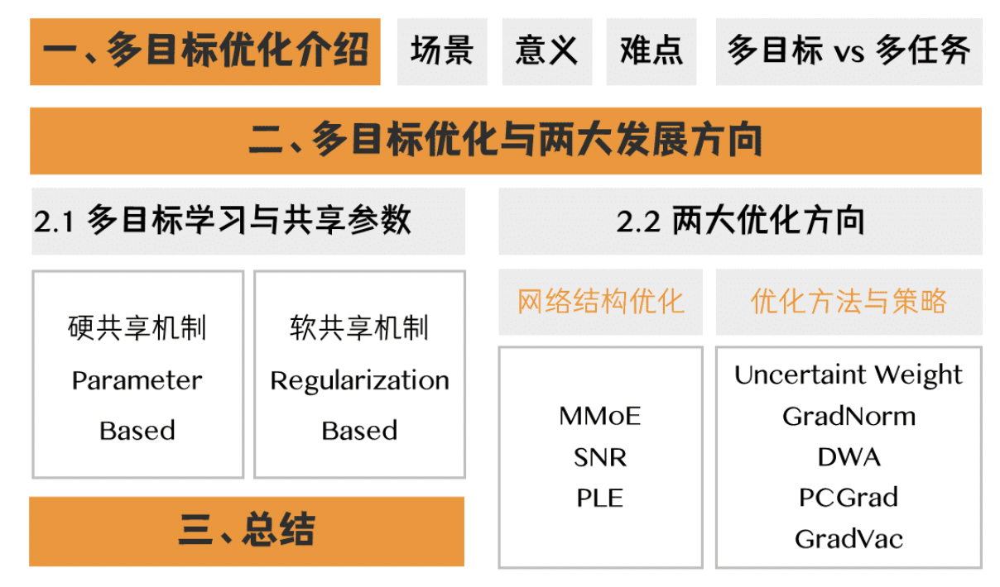

## 一、多目标优化介绍

### 1.1 什么是多目标优化场景

多目标排序是推荐排序系统中常见的技术实现，在很多推荐与排序常见中，有多个业务目标，找到一种综合排序方法使得多个目标都达到整体最优，能有最好的总体收益。

### 1.2 为什么需要多目标优化

为什么需要多目标排序呢，在实际互联网的推荐系统产品中，大多数用户反馈都不是直接评分，而是各式各样的隐式反馈，比如说用户的点击、收藏、分享、观看时长、下单购买等。
在评估用户满意度与设定优化目标时，可能有一些偏差：



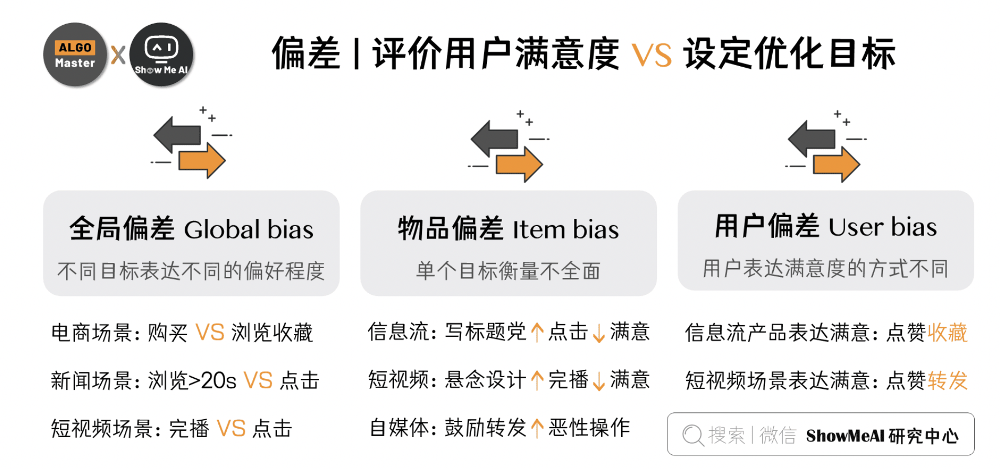

* 全局偏差/Global bias：不同目标表达不同的偏好程度。

> 电商场景中，购买行为表达的偏好高于点击浏览和收藏

> 新闻场景中，浏览时长超过20s这个行为表达的偏好高于点击

> 短视频场景，完播行为表达的偏好高于点击

* 物品偏差/Item bias：单个目标衡量不全面。

> 信息流产品中，标题党增加点击率，但降低满意度

> 短视频场景中，悬念设计提升完播率，但需要观看下一个，引发用户更多操作的不满

> 自媒体资讯产品，鼓励转发率，可能会提升『转发保平安』等恶性操作

* 用户偏差/User bias：⽤户表达满意度的⽅式不同

> 信息流产品中，用户有 深度阅读、点赞、收藏 等不同表达满意的方式

> 短视频场景中，用户有 点赞、收藏、转发 等不同表达满意的方式



下图为部分互联网产品下，用户包含信息反馈的行为路径。

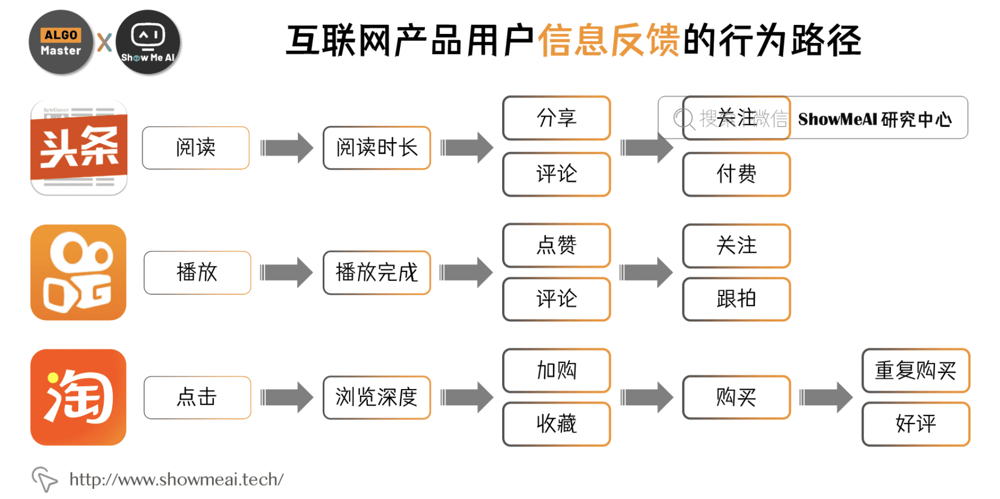

在上述众多互联网业务中，工程师优化和提升的目标可能是多个，比如，短视频推荐任务，既要点击率又要完播率；电商排序，既要点击率又要转化率。

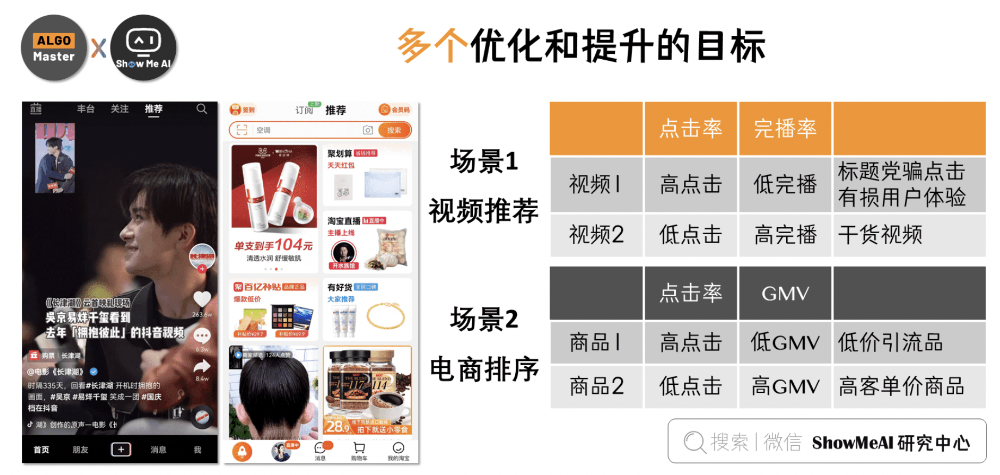

### 1.3 多目标优化的难点

多目标优化的主要技术实现是在推荐系统的『排序』环节完成，如下所示的信息流推荐中，排序环节影响最终展示结果，进而对目标效果影响最为直接。

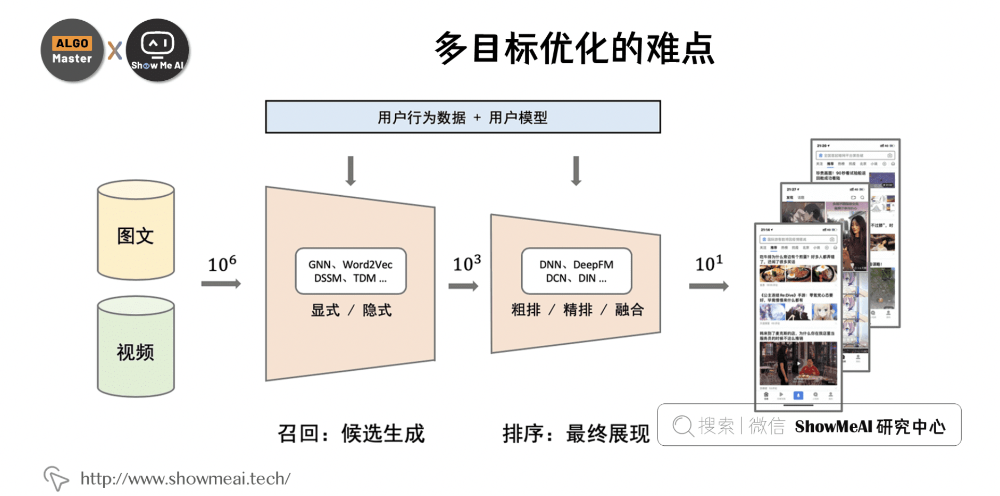

排序环节多使用CTR预估（click through rate prediction）技术来完成，业界有非常成熟的机器学习与深度学习技术方法与方案。但是，应用在多目标学习优化中，有五大难点：

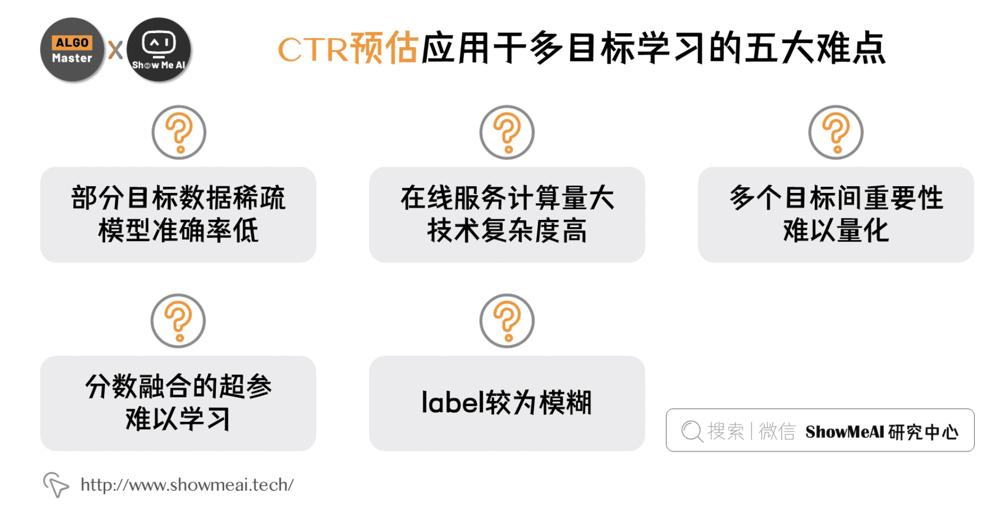

① 部分目标数据稀疏，模型准确率低。 

> 比如在电商产品中，用户下单行为显著稀疏于点击行为，下单的标签正样本数量和比例都偏小。

② 在线服务计算量⼤。 

> 通常多目标优化的模型有着更为复杂的模型结构，在线预估时，计算复杂度也更高；实时推荐任务需要有短响应时间和高并发支撑的稳定性，技术复杂度高一些。


③ 多个目标间重要性难以量化。 

> 在追求点击率又追求完播率的短视频中，这两个target如何量化权衡重要度？

④ 分数融合的超参难以学习。 

> 很多建模方案中，我们会量化得到不同的目标score，但最终融合时，涉及到的融合计算超参数不容易通过业务直接敲定，也没有合适的方法让模型学习。

⑤ Label较为模糊。 

> 很多业务中，连标签本身也是模糊的，比如资讯类产品中的阅读时长多长算长？



### 1.4 多目标vs多任务

实际技术解决方案中，有几个非常相似的概念，分别是 多任务、多目标、多类别，他们的定义和关联如下图所示：

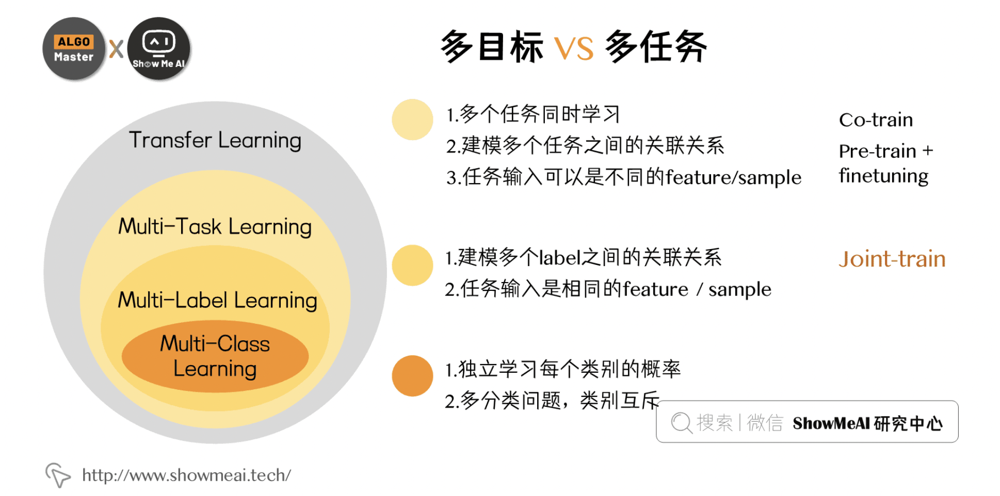

在我们这里提到的推荐多目标优化中，其实不同的目标也对应不同的 task。 

比如电商场景下，在推荐的排序阶段进行CTR建模，对同一输入样本同时预估点击率、转化率多个目标，在这个场景下，我们认为多目标多任务优化可以采用同一套方法。

我们经常使用联合训练Joint-Train的模式进行多目标优化学习，公式如下：

$L = \min_{⊖} Σ_{t=1}^T α^tL^t(⊖^{sh},⊖^t)$

其中$⊖^t$是任务$t$的独享参数，总$Loss$是每个子任务对应$Loss$的带权求和。


## 二、多目标学习与共享参数


多任务多目标学习的实现，我们现在多采用『共享』机制完成，可以在不同任务的模型参数和特征共享两方面做设计。



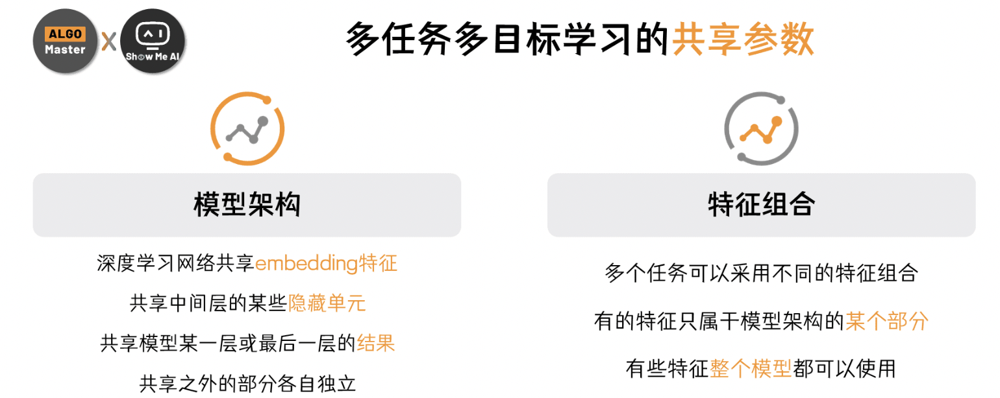

* 模型架构方面：在深度学习网络中可以共享embedding特征，或者共享中间层的某些隐藏单元，也可以是模型某一层或者最后一层的结果，并且共享之外的部分各自独立。在模型的设计中，层间关系自由组合搭配。

* 特征组合方面：多个任务可以采用不同的特征组合，有的特征只属于模型架构的某个部分，有些特征整个模型都可以使用。

### 2.1 典型的一些参数共享机制

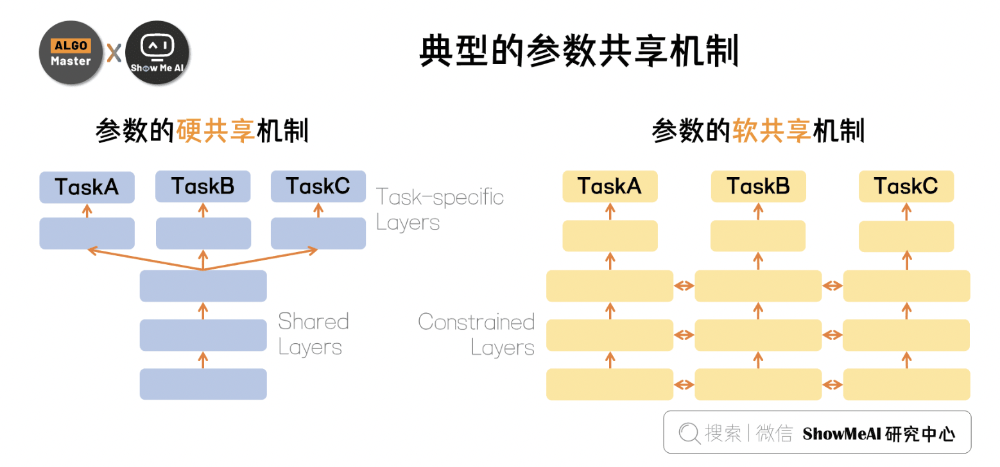

① 参数的硬共享机制 （基于参数的共享，Parameter Based）

基于参数的共享是多目标学习最常用的方法。在深度学习的网络中，通过共享特征和特征的embedding以及隐藏层的网络架构，在最后一层通过全连接+softmax的方式来区分不同任务，最后做一个线性融合来实现多目标排序。

② 参数的软共享机制 （基于约束的共享，Regularization Based）

参数的软共享机制，每个任务都有自己的参数和模型结构，可以选择哪些共享哪些不共享。最后通过正则化的方式，来拉近模型参数之间的距离，例如使用 L2 进行正则化。


### 2.2 多目标优化的4种结果


实际多目标优化，在采用共享机制设计的各种模型结构后，可能有『Well Done』、『还不错』、『不理想』、『无法接受』 这 4 种不同的结果：

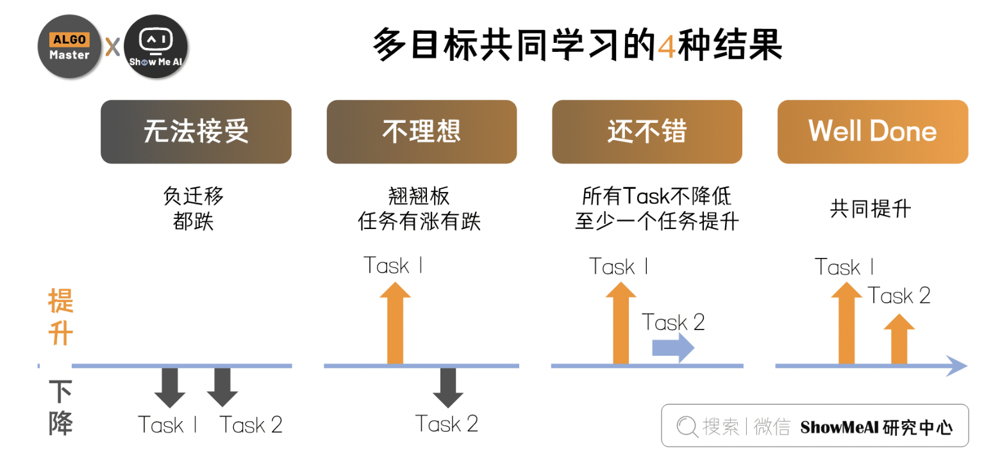

『Well Done』：最好的状态，所有任务实现共同提升。

『还不错』：其次的状态，所有任务不降低，至少一个任务提升。如果是 主任务 + 辅助任务 的搭配，能够实现牺牲辅助任务达到主任务提升的效果，也是 well done。

『不理想』：跷跷板现象，任务有涨有跌。

『无法接受』：负迁移现象，所有任务都不如从前。

## 三、多目标学习两大优化方向

为了能够更好地『共享参数』，让同个模型中多个任务和谐共存、相辅相成、相得益彰，研究界有两大优化方向，分别是：

① 网络结构优化，设计更好的参数共享位置与方式

② 优化策略提升，设计更好的优化策略以提升优化 $Loss$ 过程中的多任务平衡

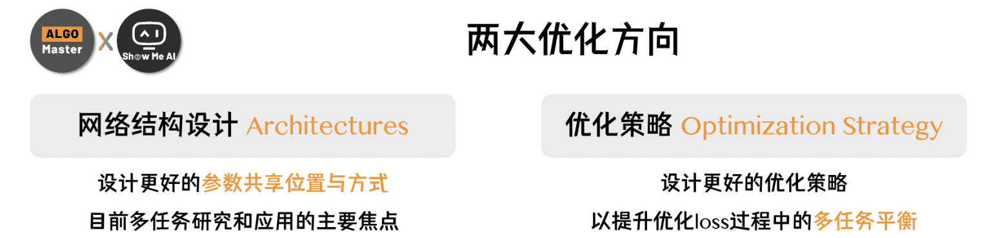

优化方向1：网络结构设计。

网络结构设计方向思考哪些参数共享，在什么位置，如何共享等。

优化方向2：优化方法与策略。

多目标优化策略从loss与梯度的视角去思考任务与任务之间的关系。

平衡loss体量（Magnitude），调节loss更新速度（Velocity），优化Gradient更新方向（Direction）。

在微观层面缓解梯度冲突，参数撕扯，在宏观层面达到多任务的平衡优化。

## 四、优化方向1：网络结构优化



### 4.1 总体思想与演进思路

网络结构设计是目前多任务研究和应用的主要焦点，它主要思考哪些参数共享，在什么位置，如何共享。
优秀合理的共享网络结构对于最终效果提升作用巨大。

近年来网络结构设计经历了 Share Bottom -> MMoE -> PLE 的典型结构变迁，重要的业界顶尖企业研究人员发表的多任务网络结构设计论文包括：

Share Bottom：早期一直在使用的方式，参数共享（hard或者soft）的方式来对多任务建模。

2018 Google MMOE：将hard的参数共享变成多个expert，通过门控来控制不同loss对每个expert的影响。

2019 Google SNR：借助简单的NAS（Neural Architecture Search），对Sub-Network进行组合，为不同目标学习各自的网络结构。

2020 腾讯 PLE：在MMOE的基础上增加了各任务独有的Expert。



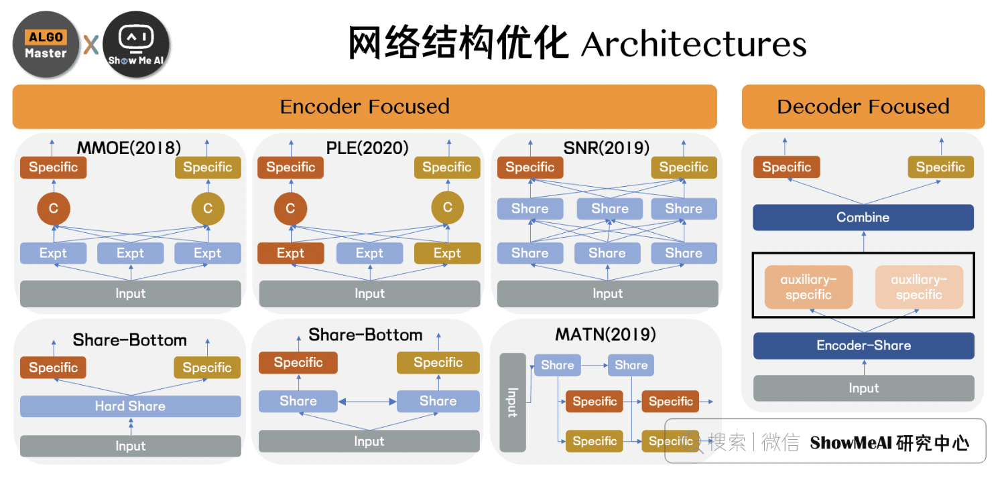

下图中对早期的Shared Bottom，MMoE，PLE三种典型网络结构及对应的动机和公式做了总结。


* Shared Bottom -> MMoE：MMoE将shared bottom分解成多个Expert，然后通过门控网络自动控制不同任务对这些Expert的梯度贡献。

* MMoE -> PLE：PLE在MMoE的基础上又为每个任务增加了自有的Expert，仅由本任务对其梯度更新。



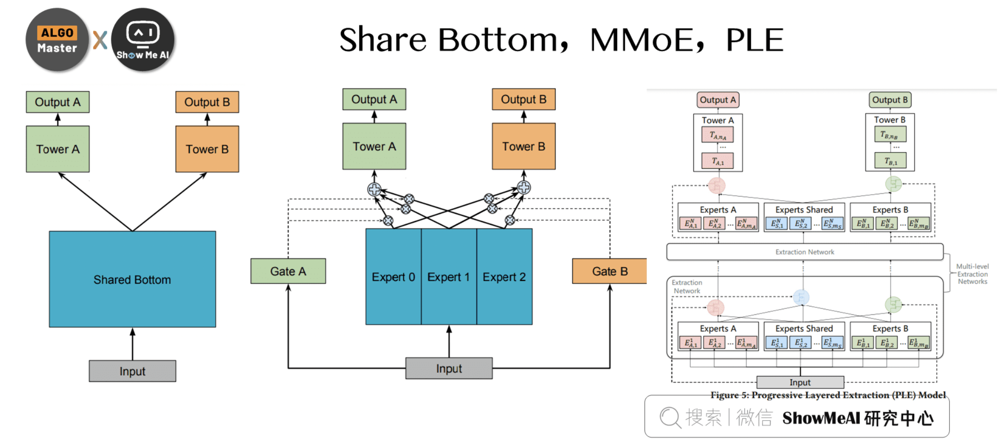

Shared Bottom动机：
底层参数统一共享，难以捕捉任务之间的差异性

MMoE动机：
相对于Shared Bottom，在不明显增加模型参数的前提下将Shared Bottom替换成多个Expert，并通过门控网络来捕捉各个任务的不同。

PLE动机：
在MMoE的基础上，不仅有共享的Experts，而且为每个任务增加了独立的Experts。
更好的降低了相关性不强的任务之间的信息共享带来的问题。


### 4.2 核心论文与典型网络结构


我们来具体看一下论文中典型的网络结构：




1）MMoE：Google KDD 2018，现CTR建模多任务学习标配

Google《Modeling task relationships in multi-task learning with multi-gate mixture-of-experts》提出的 MMoE 几乎成为各家互联网公司做多任务多目标学习排序的标配结构。

在 Google 这篇 paper 中，研究人员通过人工控制两个任务的相似度，测试和研究不同网络结构的表现效果。

MMoE 结构设计中的 Multi-gate 对于任务差异带来的冲突有一定的缓解作用，即使在多任务之间的相关性不高的情况下，也有不错的效果。 

MMoE 中不同的 expert 负责学习不同的信息内容，然后通过 gate 来组合这些信息，通过不同任务 gate 的 softmax 的热力分布差异，来表明expert对不同的目标各司其责，从而提升了效果。




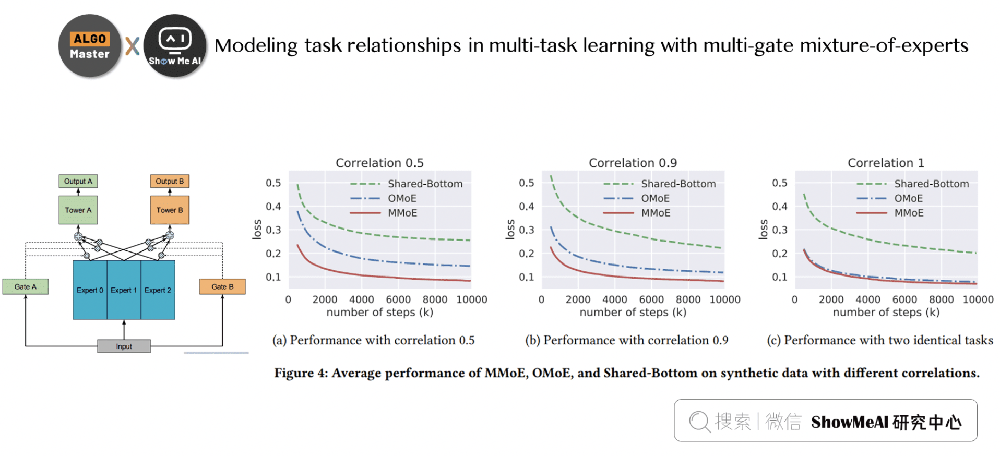

论文中大规模推荐系统数据集实验结果如下，MMoE 相对于 Shared Bottom 的方式，各指标都有明显的提升：



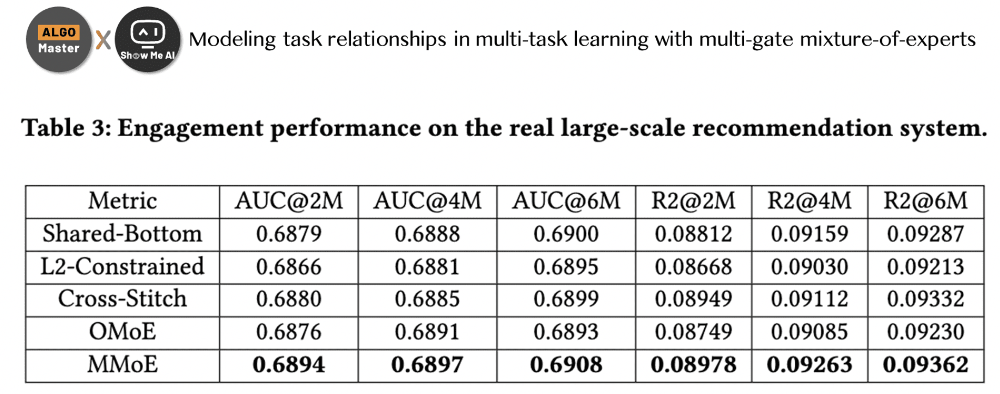

2）SNR：Google AAAI 2019，对MMoE的改进工作

Google这篇《SNR: Sub-Network Routing for Flexible Parameter Sharing in Multi-Task Learning》的思路与网络自动搜索（NAS）接近，通过动态学习产出多任务各自采用的sub-network。

研究思路是希望在更相似的任务下能学习到共享多一些的结构。



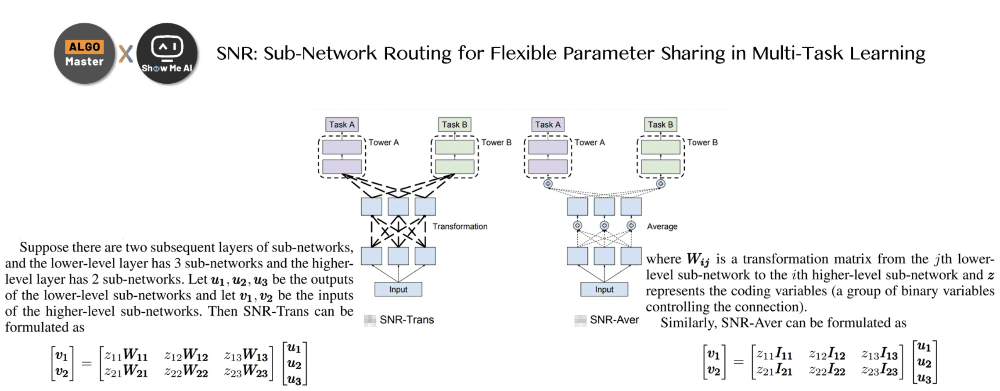

3）PLE：腾讯 RecSys 2020，改进MMoE，结构简单效果好


腾讯这篇《Progressive layered extraction (ple): A novel multi-task learning (mtl) model for personalized recommendations》提出 PLE，主要是在 MMoE 的基础上，为每个任务增加了自己的 specific expert，仅由本任务对其梯度更新。



如下图所示，在 Shared Bottom 的结构上，整个共享参数矩阵如同质量较大的物体，在梯度更新的环节，两个 $Loss$ 反向计算的梯度向量分别是 $g_1$ 和 $g_2$，是这个物体受到的两个不同方向不同大小的力，这两个力同时来挪动这个物体的位置，如果在多次更新中两个力大概率方向一致，那么就能轻松达到和谐共存、相辅相成。

反之，多个力可能出现彼此消耗、相互抵消，那么任务效果就会大打折扣。




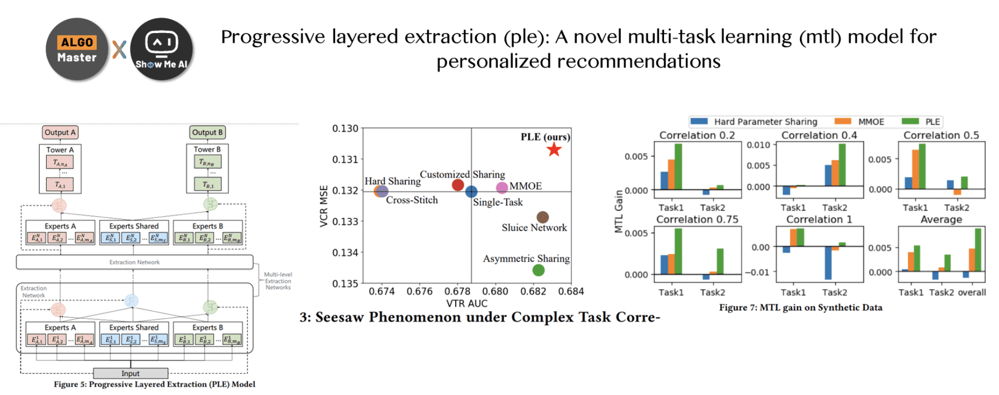

MMoE 通过『化整为零』，把一个共享参数矩阵化成多个结合 gate 的共享 Expert，这样不同的 loss 在存在相互冲突的时候，在不同的 expert 上，不同 $Loss$ 可以有相对强弱的表达，那么出现相互抵消的情况就可能减少，呈现出部分 experts 受某 task 影响较大，部分 experts 受其他 task 主导，形成『各有所得』的状态。

而PLE增加了 specific experts，能进一步保障『各有所得』，保证稳定优化。



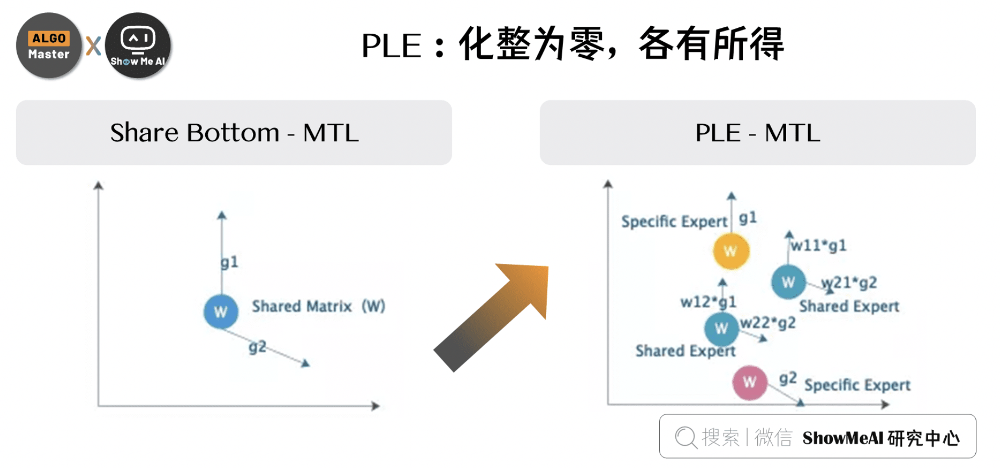

最终的paper实验结果如下：

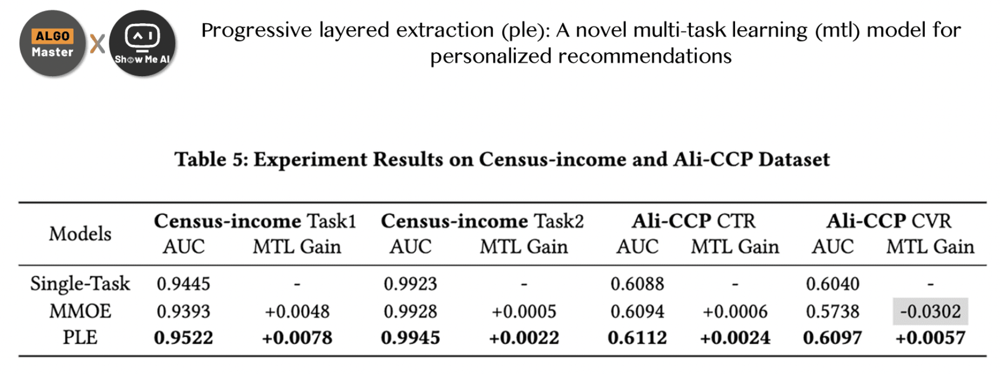

阿里的业务下，对 CTR、CVR、R3 这3个指标进行多目标优化，对于 single task 的相对提升结果如下表。其中 Shared Bottom 出现了翘翘板现象，而 PLE 实现了多目标共赢的结果。



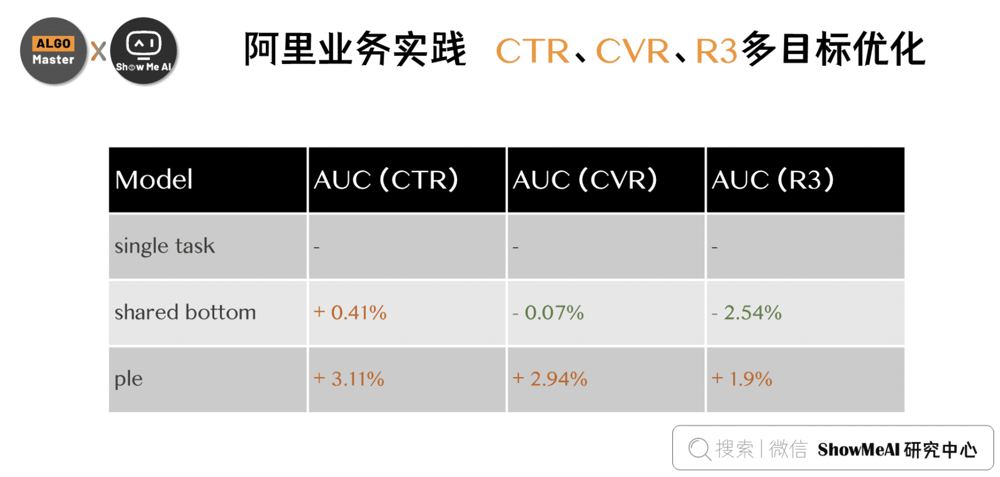

## 五、优化方向2：优化方法与策略



### 5.1 总体思想与演进思路


优化方法更多的考虑的是在已有结构下，更好地结合任务进行训练和参数优化，它从$Loss$与梯度的维度去思考不同任务之间的关系。

在优化过程中缓解梯度冲突，参数撕扯，尽量达到多任务的平衡优化。

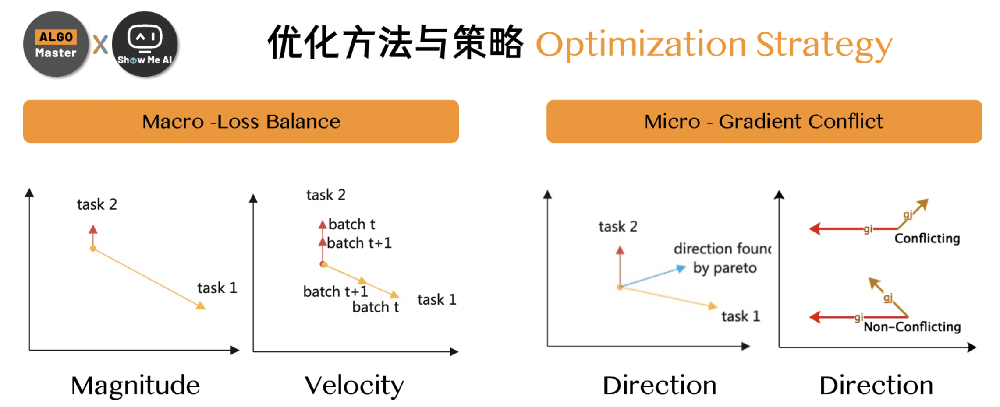

目前各式各样的多任务多目标优化方法策略，主要集中在3个问题：

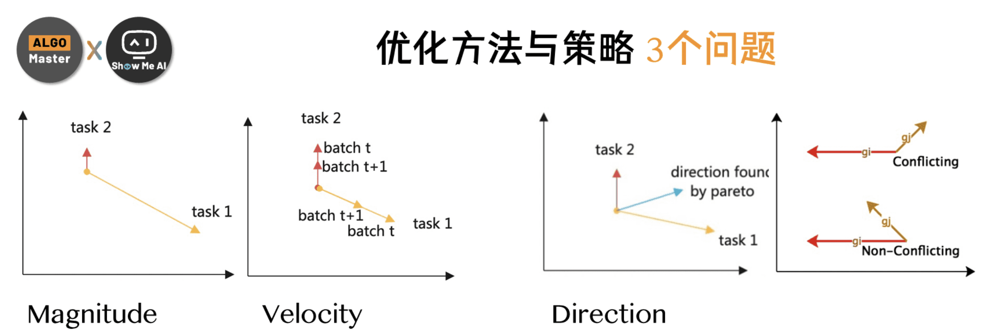

* 1）Magnitude（Loss量级）

> Loss 值有大有小，取值大的 Loss 可能会主导，如图所示，需要处理这个问题。典型的例子是二分类任务 + 回归任务的多目标优化，L2 Loss 和交叉熵损失的 Loss 大小与梯度大小的量级和幅度可能差异很大，如果不处理会对优化造成很大干扰。

* 2）Velocity（Loss学习速度）

> 不同任务因为样本的稀疏性、学习的难度不一致，在训练和优化过程中，存在 Loss 学习速度不一致的情况。如果不加以调整，可能会出现某个任务接近收敛甚至过拟合的时候，其他任务还是欠拟合的状态。

* 3）Direction（Loss梯度冲突）

> 不同任务的 Loss 对共享参数进行更新，梯度存在不同的大小和方向，相同参数被多个梯度同时更新的时候，可能会出现冲突，导致相互消耗抵消，进而出现跷跷板、甚至负迁移现象。这也是核心需要处理的问题。






### 5.2 核心论文与典型方法介绍

针对上述3大核心问题，近年来典型的研究子方向和优秀的产出方法如下图表：


> 类别：Magnitude

* Uncertainty Weight 2018：
自动学习任务的Uncertainty，给Uncertainty大的任务小权重、Uncertainty小的任务大权重。


* GradNorm 2018：
综合任务梯度的二范数和Loss下降速度，设计关于权重的损失函数Gradient Loss，并通过梯度下降更新权重。


> 类别：Velocity

* DWA 2019：
用Loss下降速度来衡量任务的学习速度，直接得出任务的权重。


> 类别：Direction

* MGDA（Pareto）2018：
提出一种基于Frank-Wolfe的优化方法。
能适应大规模问题。
并且为优化目标提供了一个上限，通过优化上限可以通过单次反向传播来更新梯度，而无需单独更新特定任务的梯度。
减小了MGDA的计算开销。

* PE-LTR（Pareto）2019：
在Pareto的基础上为每个任务引入优先级约束，并提供一个两步解法来求解新的优化目标。

* PCGrad 2020：
两个梯度冲突时，直接把一个任务的梯度投影到另一个任务的法向量上以减轻梯度干扰。

* GradVac 2021：
利用任务相关性设置梯度的相似性目标，并且自适应地对齐任务梯度以实现这些目标。






1）Uncertainty Weight

简单的多任务学习往往是把所有 $Loss$ 进行联合优化，通常需要需要手动调节他们的 $weights$。

$L_{total} = \sigma w_i L_i$

然而这种方式通常存在如下问题：

模型最后学习效果对于 $weights$ 非常敏感，否则很难同时收获对于多个任务都比较优的模型。
同时手工调节这些 $weights$ 也是非常费时费力的工作。
这篇文章提出直接建模单个任务中的uncertainty，然后通过uncertainty来指导权重的调节。
uncertainty是一个可学习的参数。


背后的含义是：
$Loss$ 大的任务，包含的uncertainty也应该多，而它的权重就应该小一点。
这样优化的结果就是往往 $Loss$ 小（『相对简单』）的任务会有一个更大的权重。
例如在分类 + 回归的多目标优化任务中，回归任务 $Loss$ 大，Uncertainty Weight给予小权重，整体效果可能是有帮助的。


2）GradNorm

Gradient normalization方法的主要思想是：

* 希望不同的任务的 Loss 量级是接近的
* 希望不同的任务以相似的速度学习


这篇文章尝试将不同任务的梯度调节到相似的量级来控制多任务网络的训练，以鼓励网络以尽可能相同的速度学习所有任务。



3）DWA

这篇paper中直接定义了一个指标来衡量任务学习的快慢，然后来指导调节任务的权重。

用这一轮loss除以上一轮loss，这样可以得到这个任务loss的下降情况用来衡量任务的学习速度，然后直接进行归一化得到任务的权重。

当一个任务loss比其他任务下降得慢时，这个任务的权重就会增加，下降得快时权重就会减小。

是只考虑了任务下降速度的简化版的Gradient normalization，简单直接。



4）PCGrad

PCGrad是Google在NIPS 2020《Gradient surgery for multi-task learning》里提出的方法，PCGrad指出MTL多目标优化存在3个问题：

① 方向不一致，导致撕扯，需要解决

② 量级不一致，导致大gradients主导，需要解决

③ 大曲率，导致容易过拟合，需要解决


解决办法如下：

* 先检测不同任务的梯度是否冲突，冲突的标准就是是否有 negative similarity；
* 如果有冲突，就把冲突的分量 clip 掉（即，把其中一个任务的梯度投影到另一个任务梯度的正交方向上）。

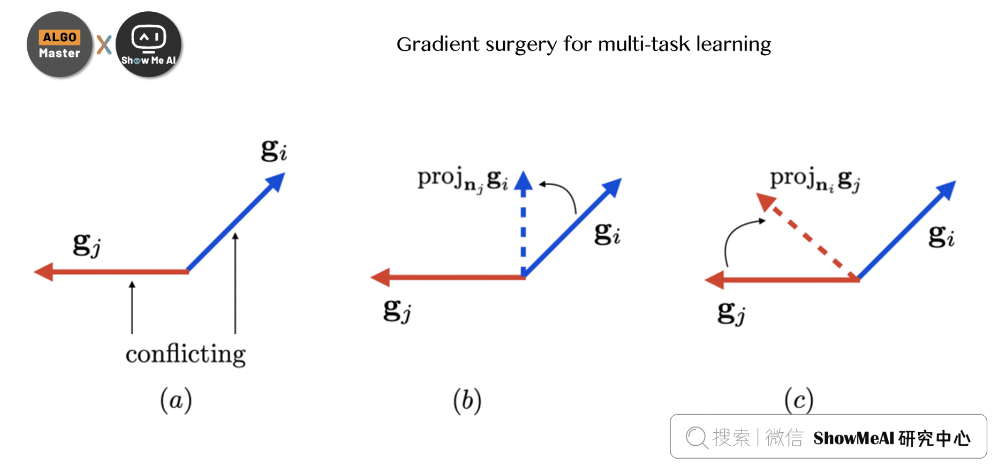

论文中的算法步骤如下：

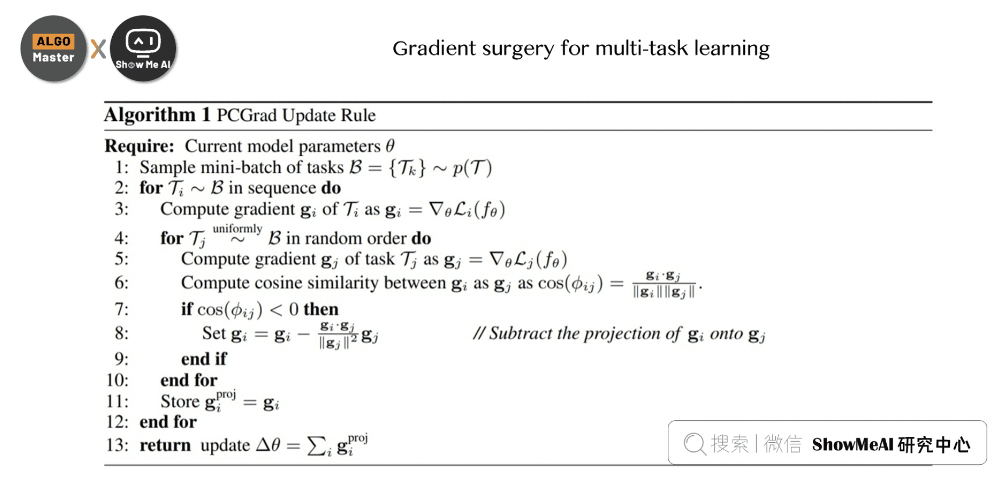

5）GradVac

GradVac是Google在ICLR 2021《Investigating and improving multi-task optimization in massively multilingual models》这篇paper里提出的方法，作为PCGrad的改进应用在多语种机器翻译任务上。

对比PCGrad，我们看看GradVac的做法：

* PCGrad只是设置了一个下界。让两个任务的cosine相似度至少是大于等于0的，不能出现负数。这个下界非常容易达到。
* 两个任务的真实相似度，其实是会逐渐收敛到一个水位。这个值可以认为是两个任务的真实相似度。
* 两个任务的Gradient相似度，应当去靠近这个相似度，而不是只满足PCGrad设置的下界。



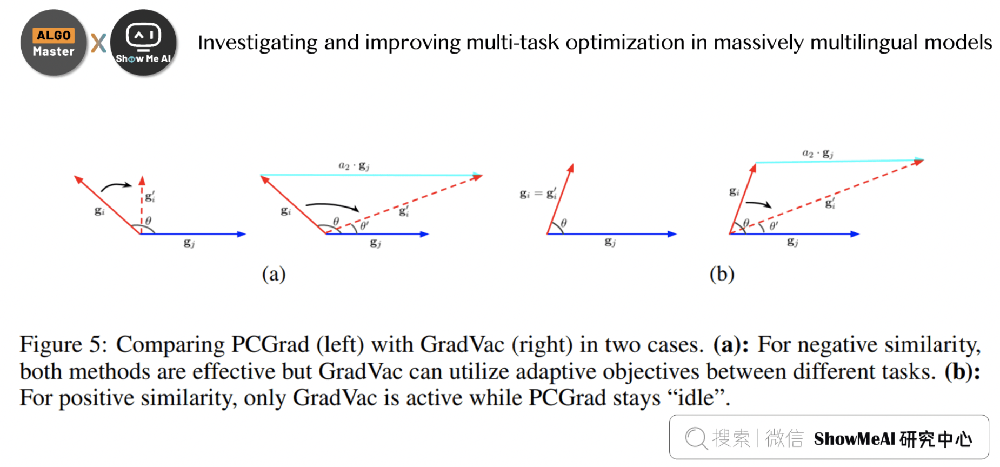

## 六、总结



总结一下，本文提到了多目标多任务场景下的优化方法，主要包含 网络结构优化 和 优化方法/策略提升 两方面，最终目标都是希望缓解任务间的冲突和内耗，尽量优化提升所有业务目标。

要构建一个promising的共赢多任务多目标解决方案，一些经验tips如下：



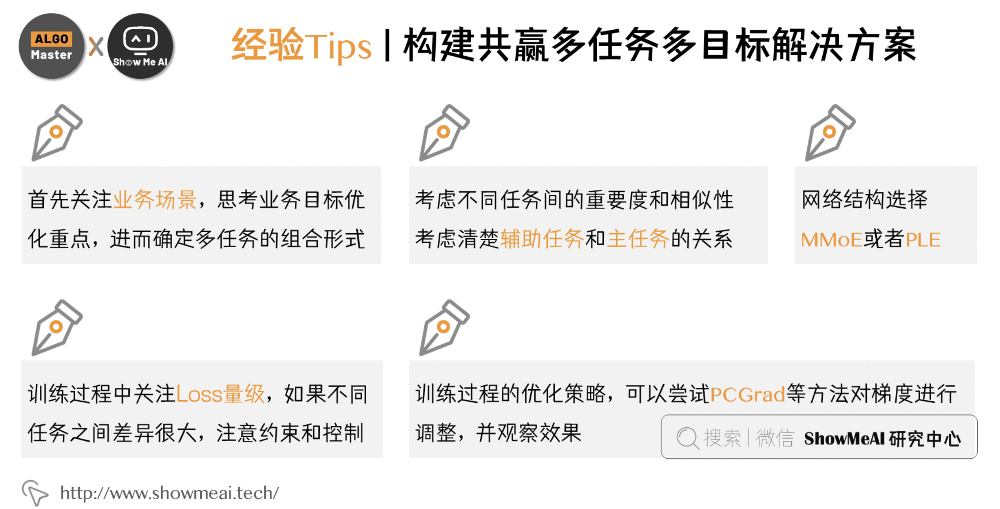

* 1）首先关注业务场景，思考业务目标优化重点，进而确定多任务的组合形式：

> 主任务 + 主任务：解决业务场景既要又要的诉求，多个任务都希望提升

> 主任务 + 辅任务：辅助任务为主任务提供一些知识信息的增强，帮助主任务提升 

* 2）考虑不同任务间的重要度和相似性，考虑清楚辅助任务和主任务的关系，实际训练过程中，可以训练优化其中1个任务，观察其他任务的loss变化

> 其他任务loss同步下降，则关联性较强

> 其他任务loss抖动或有上升趋势，要回到业务本身思考是否要联合多任务训练

* 3）网络结构选择MMoE或者PLE

* 4）训练过程中关注Loss的量级，如果不同任务之间差异很大，注意约束和控制

* 5）训练过程的优化策略，可以尝试PCGrad等方法对梯度进行调整，并观察效果